In [1]:
# Import the necessary packages

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from time import time
from collections import Counter
from sklearn.metrics import accuracy_score, f1_score, recall_score, precision_score, classification_report
from sklearn.model_selection import train_test_split, RandomizedSearchCV, KFold, cross_val_score
from sklearn.preprocessing import LabelEncoder, MinMaxScaler
from sklearn.linear_model import LogisticRegression, SGDClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import SVC
from xgboost import XGBClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import VotingClassifier, RandomForestRegressor, AdaBoostClassifier, GradientBoostingClassifier, ExtraTreesClassifier, StackingClassifier
import itertools
from sklearn.naive_bayes import GaussianNB, BernoulliNB
from sklearn.feature_selection import RFECV
from vecstack import stacking
from mlxtend.classifier import StackingCVClassifier
from mlxtend.plotting import plot_learning_curves, plot_decision_regions
from sklearn.pipeline import Pipeline
from imblearn.over_sampling import SMOTE
from sklearn.neighbors import NearestNeighbors
from sklearn.calibration import CalibratedClassifierCV
from pandas_profiling import ProfileReport

from sklearn.metrics import roc_curve
from sklearn.metrics import roc_auc_score

import itertools

import warnings
warnings.simplefilter('ignore')

# Exploratory Data Analysis

#### Data Preparation

The dataset is loaded into the workspace as a data frame and undergoes transformation or standardization before being used in the model. The attributes that do not contribute adequately in predicting the response variable have been excluded using RFECV.

Going forward, we will refer to the Explanatory variables as Features.

The dataset is split into explanatory features and response variable, for running the models.

- X : Explanatory variables (Features)
- y : Response variable (Attrition_status)

The Features have been scaled to a mean of 0 and variance of 1 to improve accuracy of the classification models. The data will be split into a 75/25 train-test set.

Correlation scores (displayed only scores > 0.8) and feature significance have been leveraged for dimensionality reduction. The remaining features will be utilized in our models:

The following techniques have been used during the analysis to improve model performance and accuracy.

- Dataset is imbalanced. So, we applied the below technique to oversample.
    - SMOTE
- Multi-collinearity was identified and addressed using
    - Correlation Matrix
- Scaling the features
- Cross Validation was implemented using the following technique
    - K Fold

A brief description of the purpose and outcome of each of the techniques is explained as they are applied to the data set.

In [2]:
# Load the data

# Project_Data = pd.read_csv('Data/CaseStudy_B.csv')
Project_Data = pd.read_csv('CaseStudy_B.csv')

In [3]:
Project_Data.shape

(5327, 28)

In [5]:
profile = ProfileReport(Project_Data, title ='"PredictingAttrition_EDA_Report', 
                        plot={'histogram': {'bins': 8}}, 
                        explorative=True)

profile.to_notebook_iframe()

profile.to_file("PredictingAttrition_EDA_Report.html")

In [6]:
profile.to_notebook_iframe()

profile.to_file("PredictingAttrition_EDA_Report.html")


In [4]:
# Check data type and not null counts of all the columns

Project_Data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5327 entries, 0 to 5326
Data columns (total 28 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   Var1    5314 non-null   float64
 1   Var2    5327 non-null   float64
 2   Var3    5327 non-null   float64
 3   Var4    5304 non-null   float64
 4   Var5    5327 non-null   float64
 5   Var6    5327 non-null   float64
 6   Var7    5327 non-null   float64
 7   Var8    5327 non-null   float64
 8   Var9    5327 non-null   float64
 9   Var10   5327 non-null   float64
 10  Var11   5327 non-null   float64
 11  Var12   5327 non-null   float64
 12  Var13   5327 non-null   float64
 13  Var14   5327 non-null   float64
 14  Var15   5327 non-null   float64
 15  Var16   5327 non-null   float64
 16  Var17   5327 non-null   float64
 17  Var18   5327 non-null   float64
 18  Var19   5327 non-null   float64
 19  Var20   5327 non-null   float64
 20  Var21   5327 non-null   float64
 21  Var22   5327 non-null   float64
 22  

In [5]:
# Get NULL counts by column

Project_Data.isnull().sum()

Var1       13
Var2        0
Var3        0
Var4       23
Var5        0
Var6        0
Var7        0
Var8        0
Var9        0
Var10       0
Var11       0
Var12       0
Var13       0
Var14       0
Var15       0
Var16       0
Var17       0
Var18       0
Var19       0
Var20       0
Var21       0
Var22       0
Var23       0
Var24    1191
Var25    1191
Var26    1191
Var27       1
Y           0
dtype: int64

In [6]:
# Drop columns that have high % of NULLs

Project_Data_drop_na = Project_Data.drop(columns=['Var24', 'Var25', 'Var26'], axis = 1)

In [7]:
# Drop rows with NULL values in the dataset

Project_Data_drop_na.dropna(inplace=True)


In [8]:
Project_Data_drop_na.shape

(5290, 25)

In [9]:
# Check Unique values by column
#### This will help us identify the categorical values

Project_Data_drop_na.nunique(dropna=False)

Var1     5290
Var2        2
Var3      342
Var4       36
Var5     1205
Var6        2
Var7        2
Var8        2
Var9        3
Var10      16
Var11     253
Var12       6
Var13      33
Var14      13
Var15       7
Var16      12
Var17      99
Var18      79
Var19      99
Var20      32
Var21      50
Var22       6
Var23       7
Var27      10
Y           2
dtype: int64

In [10]:
# Review the Categorical variables. 
#### On having a closer look, columns x32 and x37 have special characters. 
#### The special characters need to be removed and the columns would be converted to float.

#print('Unique values of Project_Data.Var1:: \n',Project_Data.Var1.value_counts(dropna = False))
print('\nUnique values of Project_Data.Var2:: \n',Project_Data.Var2.value_counts(dropna = False))
#print('\nUnique values of Project_Data.Var3:: \n',Project_Data.Var3.value_counts(dropna = False))
#print('\nUnique values of Project_Data.Var4:: \n',Project_Data.Var4.value_counts(dropna = False))
#print('\nUnique values of Project_Data.Var5:: \n',Project_Data.Var5.value_counts(dropna = False))
print('\nUnique values of Project_Data.Var6:: \n',Project_Data.Var6.value_counts(dropna = False))
print('\nUnique values of Project_Data.Var7:: \n',Project_Data.Var7.value_counts(dropna = False))
print('\nUnique values of Project_Data.Var8:: \n',Project_Data.Var8.value_counts(dropna = False))
print('\nUnique values of Project_Data.Var9:: \n',Project_Data.Var9.value_counts(dropna = False))
print('\nUnique values of Project_Data.Var10:: \n',Project_Data.Var10.value_counts(dropna = False))
print('\nUnique values of Project_Data.Var12:: \n',Project_Data.Var12.value_counts(dropna = False))
#print('\nUnique values of Project_Data.Var13:: \n',Project_Data.Var13.value_counts(dropna = False))
#print('\nUnique values of Project_Data.Var14:: \n',Project_Data.Var14.value_counts(dropna = False))
print('\nUnique values of Project_Data.Var15:: \n',Project_Data.Var15.value_counts(dropna = False))
#print('\nUnique values of Project_Data.Var16:: \n',Project_Data.Var16.value_counts(dropna = False))
#print('\nUnique values of Project_Data.Var21:: \n',Project_Data.Var21.value_counts(dropna = False))
print('\nUnique values of Project_Data.Var22:: \n',Project_Data.Var22.value_counts(dropna = False))
print('\nUnique values of Project_Data.Var23:: \n',Project_Data.Var23.value_counts(dropna = False))
print('\nUnique values of Project_Data.Var27:: \n',Project_Data.Var27.value_counts(dropna = False))


Unique values of Project_Data.Var2:: 
 1.0    5096
0.0     231
Name: Var2, dtype: int64

Unique values of Project_Data.Var6:: 
 1.0    4220
0.0    1107
Name: Var6, dtype: int64

Unique values of Project_Data.Var7:: 
 0.0    5315
1.0      12
Name: Var7, dtype: int64

Unique values of Project_Data.Var8:: 
 0.0    4430
1.0     897
Name: Var8, dtype: int64

Unique values of Project_Data.Var9:: 
 1.0    3567
3.0    1714
2.0      46
Name: Var9, dtype: int64

Unique values of Project_Data.Var10:: 
 16.0    1825
4.0     1179
10.0     860
9.0      342
15.0     302
3.0      297
13.0     139
2.0      108
14.0      87
6.0       66
8.0       64
11.0      33
7.0       10
5.0        6
1.0        5
12.0       4
Name: Var10, dtype: int64

Unique values of Project_Data.Var12:: 
 6.0    1721
1.0    1409
4.0    1199
2.0     551
5.0     399
3.0      48
Name: Var12, dtype: int64

Unique values of Project_Data.Var15:: 
 99.0    3497
29.0     414
33.0     352
32.0     342
30.0     312
31.0     302
34.0     1

# One Hot encoding for Categorical Variables

One Hot Encoding (ohe) is a process by which categorical variables are converted into a form that could be provided to ML algorithms to do a better job in prediction. The input to this transformer should be an array-like of integers or strings, denoting the values taken on by categorical (discrete) features.

#### Options used for pd.get_dummies
- data - Data of which to get dummy indicators 
    - Project_Data_drop_na
- prefix_sep - If appending prefix, separator/delimiter to use. Or pass a list or dictionary as with prefix.
    - "__"
- drop_first - Whether to get k-1 dummies out of k categorical levels by removing the first level
    - True
- columns - Column names in the DataFrame to be encoded.
    - cat_columns - List of Categorical features to passed through ohe

In [11]:
# Listing Categorical Columns and creating One hot encoding for those variables

cat_columns = ['Var2', 'Var6', 'Var7', 'Var8', 'Var9', 'Var10', 'Var12', 'Var15', 'Var22', 'Var23', 'Var27']
Project_Data_ohe = pd.get_dummies(Project_Data_drop_na, prefix_sep="__", drop_first=True, columns=cat_columns)

In [12]:
Project_Data_ohe.isnull().sum()

Var1           0
Var3           0
Var4           0
Var5           0
Var11          0
              ..
Var27__6.0     0
Var27__7.0     0
Var27__8.0     0
Var27__9.0     0
Var27__10.0    0
Length: 66, dtype: int64

In [13]:
Project_Data_ohe.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 5290 entries, 0 to 5326
Data columns (total 66 columns):
Var1           5290 non-null float64
Var3           5290 non-null float64
Var4           5290 non-null float64
Var5           5290 non-null float64
Var11          5290 non-null float64
Var13          5290 non-null float64
Var14          5290 non-null float64
Var16          5290 non-null float64
Var17          5290 non-null float64
Var18          5290 non-null float64
Var19          5290 non-null float64
Var20          5290 non-null float64
Var21          5290 non-null float64
Y              5290 non-null float64
Var2__1.0      5290 non-null uint8
Var6__1.0      5290 non-null uint8
Var7__1.0      5290 non-null uint8
Var8__1.0      5290 non-null uint8
Var9__2.0      5290 non-null uint8
Var9__3.0      5290 non-null uint8
Var10__2.0     5290 non-null uint8
Var10__3.0     5290 non-null uint8
Var10__4.0     5290 non-null uint8
Var10__5.0     5290 non-null uint8
Var10__6.0     5290 non-n

# Scaling the data set

It is a step of Data Pre Processing which is applied to independent variables or features of data. It basically helps to normalise the data within a particular range. Sometimes, it also helps in speeding up the calculations in an algorithm. The Features have been scaled to a mean of 0 and variance of 1 to improve accuracy of the classification models.

*fit_transform* within MinMaxScaler() function fits to data, then transform it. Fits transformer to X and y with optional parameters fit_params and returns a transformed version of X.

In [14]:
scaler = MinMaxScaler()

In [15]:
Project_Data_ohe_scaled = pd.DataFrame(scaler.fit_transform(Project_Data_ohe), columns=Project_Data_ohe.columns)

In [16]:
Project_Data_ohe_scaled.describe()

,Var1,Var3,Var4,Var5,Var11,Var13,Var14,Var16,Var17,Var18,...,Var23__7.0,Var27__2.0,Var27__3.0,Var27__4.0,Var27__5.0,Var27__6.0,Var27__7.0,Var27__8.0,Var27__9.0,Var27__10.0
count,5290.000000,5290.000000,5290.000000,5290.000000,5290.000000,5290.000000,5290.000000,5290.000000,5290.000000,5290.000000,...,5290.000000,5290.000000,5290.000000,5290.000000,5290.000000,5290.000000,5290.000000,5290.000000,5290.000000,5290.000000
mean,0.395476,0.489883,0.338750,0.392145,0.403022,0.835556,0.179143,0.505499,0.401388,0.111259,...,0.240454,0.116446,0.000756,0.022873,0.001701,0.268053,0.202647,0.244612,0.133648,0.001701
std,0.228397,0.263949,0.148429,0.290920,0.408023,0.133002,0.294723,0.297452,0.421005,0.278230,...,0.427399,0.320789,0.027490,0.149514,0.041216,0.442987,0.402009,0.429898,0.340306,0.041216
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.208807,0.267378,0.323529,0.131933,0.000000,0.787879,0.000000,0.272727,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,0.380837,0.478673,0.397059,0.306589,0.413700,0.848485,0.000000,0.545455,0.320000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,0.560034,0.691943,0.397059,0.666383,0.820000,0.939394,0.333333,0.727273,1.000000,0.070000,...,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000
max,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


# Correlation Matrix

We used correlation plot to identify the attributes in the original dataset that appeared to be highly collinear. In other words, one predictor variable in the regression model can be linearly predicted from the others with a substantial degree of accuracy.

Since the data set is huge, the correlation plot was not very informative when plotted with all the features. So, we filtered only those features that had a score greater than 0.8 in the below figure. Based on the analysis, we dropped $x6$ and $x41$ as they were highly correlated with $x2$ and $x38$ respectively.

corr = 1 were excluded to avoid displaying self correlated features.

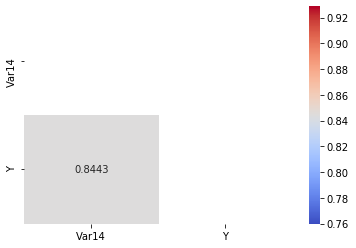

In [17]:
corr = Project_Data_ohe_scaled.corr()

kot = corr[(corr>=.8) & (corr<1)]
kot.dropna(axis=0, how='all', inplace = True)
kot.dropna(axis=1, how='all', inplace = True)
#plt.figure(figsize=(12,8))
#sns.heatmap(kot, annot=True, fmt='.4g', cmap= 'coolwarm', linewidths=3, linecolor='black')

matrix = np.triu(kot)
sns.heatmap(kot, annot=True, fmt='.4g', cmap= 'coolwarm', mask = matrix)

In [18]:
Project_Data_final = Project_Data_ohe_scaled.drop(['Var14'], axis = 1)

# SMOTE

# Start Modeling

### Splitting data set into Response and Explanatory Variables 

In [19]:
X = Project_Data_final.drop(columns=['Y'], axis=1)
y = Project_Data_final.Y

In [20]:
#smote = SMOTE()
#X_smote, y_smote = smote.fit_sample(X.astype('float'), y)

### Train Test Split

This technique provides us a way of voluntarily holding back part of the data to test whether the model works. If we use our entire dataset to train the model, then the model will alway predict the correct category for any entry in the data set. This process of setting aside a part of the dataset voluntarily to evaluate the model stops the model from being too optimistic when predicting the outcome. Training the model on the entire data set could also lead to data snooping bias. This kind of bias results from refining too many parameters to improve the model's performance on a data set. In our analysis, we will split the data into training and test data sets (75:25) randomly. 

In [21]:
#X_train, X_test, y_train, y_test = train_test_split(X_smote, y_smote, test_size=0.25, random_state=10)
X_train_d, X_test, y_train_d, y_test = train_test_split(X, y, test_size=0.25, random_state=10)

In [22]:
smote = SMOTE()
X_train, y_train = smote.fit_sample(X_train_d.astype('float'), y_train_d)

#### Check the response ratio in Train-Test split

Let's check the ratio of the response variables and compare it with that of the Train and Test dataset. The below results confirm that the ratio is retained and hence we can proceed with K-Fold Cross-Validation(CV) instead of Stratifid K-Fold CV.

In [23]:
sum(Project_Data_ohe_scaled['Y']==0)/sum(Project_Data_ohe_scaled['Y']==1)

1.929125138427464

In [24]:
sum(y_test==0)/sum(y_test==1)

2.0

In [25]:
sum(y_train==0)/sum(y_train==1)

1.0

#### Set Baseline of the Cost Model

We start with executing selective models with default parameters on the complete data set. The confusion matrix along with the classification report and the accuracy of the model is printed below. The function confusion_mat displays the confusion matrix (using pd.crosstab) and classification report. It additionally extracts the FP and FN case counts and calculates the cost to the business partner.

In [26]:
rand_state = 10
n_iterations = 5

### K-fold Cross-Validation

This is a statistical method of evaluating generalization performance that is more stable and thorough than using a split into a training and test set. In cross-validation, the data set is split multiple times and the model is trained on each of these splits. For our analysis, we will be using k-fold cross-validation. 

KFold divides all the samples in groups of samples, called folds (if , this is equivalent to the Leave One Out strategy), of equal sizes (if possible). The prediction function is learned using folds, and the fold left out is used for test.

Parameters for k-fold CV:
- n_splitsint - Number of folds
    - 5
- random_state - random_state is the seed used by the random number generator
    - 10

In [27]:
cv = KFold(n_splits=n_iterations, random_state=rand_state)

In [28]:
results_df = pd.DataFrame(columns=['Classifier', 'Features', 'Accuracy', 'Parameters', 'Recall', 
                                   'Precision', 'FPR', 'TPR', 'AUC', 'True_Positives', 
                                   'True_Negatives', 'False_Positives', 'False_Negatives', 'Cost'])
results_df

,Classifier,Features,Accuracy,Parameters,Recall,Precision,FPR,TPR,AUC,True_Positives,True_Negatives,False_Positives,False_Negatives,Cost


In [29]:
def confusion_mat(y_test, y_pred):
    print('Confusion Matrix::\n')
    print(pd.crosstab(y_test, y_pred))
    print()
    print('Classification Report::')
    print(classification_report(y_test, y_pred))
    TN = pd.crosstab(y_test, y_pred).iloc[0, 0]
    FP = pd.crosstab(y_test, y_pred).iloc[0, 1]
    FN = pd.crosstab(y_test, y_pred).iloc[1, 0]
    TP = pd.crosstab(y_test, y_pred).iloc[1, 1]
    Cost = (FP*10)+(FN*500)
    Recall = recall_score(y_test, y_pred, average='weighted')
    Precision = precision_score(y_test, y_pred)
    Accuracy = accuracy_score(y_test, y_pred)
    return(FP, FN, TP, TN, Cost, Accuracy, Recall, Precision)

In [30]:
clfsDict = {'Logistic Regression': LogisticRegression(solver = 'lbfgs', random_state=rand_state),
            'SVM (SVC)': SVC(gamma = 0.5, random_state=rand_state, probability=True), 
            'Gaussian Naive-Bayes': GaussianNB(),
            'Bernoulli Naive-Bayes': BernoulliNB(),
            'Decision Tree': DecisionTreeClassifier(random_state=rand_state),
            'Random Forest': RandomForestClassifier(n_estimators=100, random_state=rand_state),
            'XGB': XGBClassifier(random_state=rand_state)}

In [31]:
#%%time
start = time()

model_run_stats = []

for mdl, clf in clfsDict.items():
    start_1 = time()
    acc = cross_val_score(clf,X,y=y,cv=cv)
    clf.fit(X_train, y_train)
    y_pred_full_data = clf.predict(X_test)
    y_pred_proba_full_data = clf.predict_proba(X_test)[:, 1]
    fpr, tpr, _ = roc_curve(y_test,  y_pred_proba_full_data)
    auc = roc_auc_score(y_test, y_pred_proba_full_data)
    (FP, FN, TP, TN, Cost, Accuracy, Recall, Precision) = confusion_mat(y_test, y_pred_full_data)
    results_df = results_df.append({'Classifier':mdl
                                    , 'Features':'Full'
                                    , 'Parameters': 'Default'
                                    , 'Accuracy': Accuracy
                                    , 'Recall': Recall
                                    , 'Precision': Precision
                                    , 'FPR': fpr
                                    , 'TPR': tpr
                                    , 'AUC': auc
                                    , 'True_Positives': TP
                                    , 'True_Negatives': TN
                                    , 'False_Positives': FP
                                    , 'False_Negatives': FN
                                    , 'Cost': Cost
                                   }
                                   , ignore_index=True
                                  )
    print()
    print('Process Time:: %0f' %(time()-start_1))
    print()
    
model_run_stats

print('Wall Time:: %0f' %(time()-start))

Confusion Matrix::

col_0  0.0  1.0
Y              
0.0    882    0
1.0      0  441

Classification Report::
              precision    recall  f1-score   support

         0.0       1.00      1.00      1.00       882
         1.0       1.00      1.00      1.00       441

    accuracy                           1.00      1323
   macro avg       1.00      1.00      1.00      1323
weighted avg       1.00      1.00      1.00      1323


Process Time:: 0.224401

Confusion Matrix::

col_0  0.0  1.0
Y              
0.0    882    0
1.0      0  441

Classification Report::
              precision    recall  f1-score   support

         0.0       1.00      1.00      1.00       882
         1.0       1.00      1.00      1.00       441

    accuracy                           1.00      1323
   macro avg       1.00      1.00      1.00      1323
weighted avg       1.00      1.00      1.00      1323


Process Time:: 28.283318

Confusion Matrix::

col_0  0.0  1.0
Y              
0.0    882    0
1.0    

In [32]:
results_df

,Classifier,Features,Accuracy,Parameters,Recall,Precision,FPR,TPR,AUC,True_Positives,True_Negatives,False_Positives,False_Negatives,Cost
0,Logistic Regression,Full,1.0,Default,1.0,1.0,"[0.0, 0.0, 0.0, 1.0]","[0.0, 0.0022675736961451248, 1.0, 1.0]",1.0,441,882,0,0,0
1,SVM (SVC),Full,1.0,Default,1.0,1.0,"[0.0, 0.0, 0.0, 1.0]","[0.0, 0.0022675736961451248, 1.0, 1.0]",1.0,441,882,0,0,0
2,Gaussian Naive-Bayes,Full,1.0,Default,1.0,1.0,"[0.0, 0.0, 1.0]","[0.0, 1.0, 1.0]",1.0,441,882,0,0,0
3,Bernoulli Naive-Bayes,Full,1.0,Default,1.0,1.0,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0022675736961451248, 0.009070294784580...",1.0,441,882,0,0,0
4,Decision Tree,Full,1.0,Default,1.0,1.0,"[0.0, 0.0, 1.0]","[0.0, 1.0, 1.0]",1.0,441,882,0,0,0
5,Random Forest,Full,1.0,Default,1.0,1.0,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.4671201814058957, 0.6485260770975056, ...",1.0,441,882,0,0,0
6,XGB,Full,1.0,Default,1.0,1.0,"[0.0, 0.0, 1.0]","[0.0, 1.0, 1.0]",1.0,441,882,0,0,0


In [33]:
results_df.drop(results_df.index, inplace=True)

In [34]:
# Drop Var15 because it is contributing to leakage.

X_train = X_train[X_train.columns.drop(list(X_train.filter(regex='Var15')))]
X_test = X_test[X_test.columns.drop(list(X_test.filter(regex='Var15')))]

In [35]:
#%%time
start = time()

model_run_stats = []

for mdl, clf in clfsDict.items():
    start_1 = time()
    acc = cross_val_score(clf,X,y=y,cv=cv)
    clf.fit(X_train, y_train)
    y_pred_full_data = clf.predict(X_test)
    y_pred_proba_full_data = clf.predict_proba(X_test)[:, 1]
    fpr, tpr, _ = roc_curve(y_test,  y_pred_proba_full_data)
    auc = roc_auc_score(y_test, y_pred_proba_full_data)
    (FP, FN, TP, TN, Cost, Accuracy, Recall, Precision) = confusion_mat(y_test, y_pred_full_data)
    results_df = results_df.append({'Classifier':mdl
                                    , 'Features':'Full'
                                    , 'Parameters': 'Default'
                                    , 'Accuracy': Accuracy
                                    , 'Recall': Recall
                                    , 'Precision': Precision
                                    , 'FPR': fpr
                                    , 'TPR': tpr
                                    , 'AUC': auc
                                    , 'True_Positives': TP
                                    , 'True_Negatives': TN
                                    , 'False_Positives': FP
                                    , 'False_Negatives': FN
                                    , 'Cost': Cost
                                   }
                                   , ignore_index=True
                                  )
    print()
    print('Process Time:: %0f' %(time()-start_1))
    print()
    
model_run_stats

print('Wall Time:: %0f' %(time()-start))

Confusion Matrix::

col_0  0.0  1.0
Y              
0.0    821   61
1.0     99  342

Classification Report::
              precision    recall  f1-score   support

         0.0       0.89      0.93      0.91       882
         1.0       0.85      0.78      0.81       441

    accuracy                           0.88      1323
   macro avg       0.87      0.85      0.86      1323
weighted avg       0.88      0.88      0.88      1323


Process Time:: 0.543654

Confusion Matrix::

col_0  0.0  1.0
Y              
0.0    833   49
1.0    108  333

Classification Report::
              precision    recall  f1-score   support

         0.0       0.89      0.94      0.91       882
         1.0       0.87      0.76      0.81       441

    accuracy                           0.88      1323
   macro avg       0.88      0.85      0.86      1323
weighted avg       0.88      0.88      0.88      1323


Process Time:: 37.361265

Confusion Matrix::

col_0  0.0  1.0
Y              
0.0    291  591
1.0    

In [36]:
results_df

,Classifier,Features,Accuracy,Parameters,Recall,Precision,FPR,TPR,AUC,True_Positives,True_Negatives,False_Positives,False_Negatives,Cost
0,Logistic Regression,Full,0.879063,Default,0.879063,0.848635,"[0.0, 0.0, 0.0, 0.0011337868480725624, 0.00113...","[0.0, 0.0022675736961451248, 0.562358276643991...",0.934063,342,821,61,99,50110
1,SVM (SVC),Full,0.881330,Default,0.881330,0.871728,"[0.0, 0.0, 0.0, 0.0011337868480725624, 0.00113...","[0.0, 0.0022675736961451248, 0.274376417233560...",0.909320,333,833,49,108,54490
2,Gaussian Naive-Bayes,Full,0.540438,Default,0.540438,0.417734,"[0.0, 0.5782312925170068, 0.5816326530612245, ...","[0.0, 0.9206349206349206, 0.927437641723356, 0...",0.682369,424,291,591,17,14410
3,Bernoulli Naive-Bayes,Full,0.801209,Default,0.801209,0.676587,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0022675736961451248, 0.006802721088435...",0.889304,341,719,163,100,51630
4,Decision Tree,Full,0.885865,Default,0.885865,0.812500,"[0.0, 0.09863945578231292, 1.0]","[0.0, 0.854875283446712, 1.0]",0.878118,377,795,87,64,32870
5,Random Forest,Full,0.923658,Default,0.923658,0.969613,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.23129251700680273, 0.3242630385487528,...",0.961519,351,871,11,90,45110
6,XGB,Full,0.925926,Default,0.925926,0.938619,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0045351473922902496, 0.013605442176870...",0.963601,367,858,24,74,37240


# Feature Reduction (RFECV)

The classes in the sklearn.feature_selection module can be used for feature selection/dimensionality reduction on sample sets, either to improve estimators’ accuracy scores or to boost their performance on very high-dimensional datasets. We have used Recursive Feature Elimination with Cross-Validation to limit the number of features input to the model.

Given an external estimator that assigns weights to features (e.g., the coefficients of a linear model), recursive feature elimination (RFE) is to select features by recursively considering smaller and smaller sets of features. First, the estimator is trained on the initial set of features and the importance of each feature is obtained either through a coef_ attribute or through a feature_importances_ attribute. Then, the least important features are pruned from current set of features.That procedure is recursively repeated on the pruned set until the desired number of features to select is eventually reached.

RFECV performs RFE in a cross-validation loop to find the optimal number of features.

Parameters for RFECV:
- estimator - A supervised learning estimator with a fit method that provides information about feature importance.
    - RandomForestClassifier
- step - If greater than or equal to 1, then step corresponds to the number of features to remove at each iteration.
    - 4
- cv - Determines the cross-validation splitting strategy. Integer value specifies the number of folds.
    - 3
- scoring - A scoring method to determine which score to maximize
    - recall

In [37]:
clf = RandomForestClassifier(n_estimators=100, random_state=rand_state)
selector = RFECV(estimator=clf, step = 4, cv=3, scoring='recall')

In [38]:
#%%time

feature_fit = selector.fit(X_train, y_train)

print('The number of selected features with CV:: ', feature_fit.n_features_)
print('Selected Features:: ', X_train.columns[selector.support_])

The number of selected features with CV::  54
Selected Features::  Index(['Var1', 'Var3', 'Var4', 'Var5', 'Var11', 'Var13', 'Var16', 'Var17',
       'Var18', 'Var19', 'Var20', 'Var21', 'Var2__1.0', 'Var6__1.0',
       'Var7__1.0', 'Var8__1.0', 'Var9__2.0', 'Var9__3.0', 'Var10__2.0',
       'Var10__3.0', 'Var10__4.0', 'Var10__6.0', 'Var10__7.0', 'Var10__8.0',
       'Var10__9.0', 'Var10__10.0', 'Var10__11.0', 'Var10__13.0',
       'Var10__14.0', 'Var10__15.0', 'Var10__16.0', 'Var12__2.0', 'Var12__3.0',
       'Var12__4.0', 'Var12__5.0', 'Var12__6.0', 'Var22__1.0', 'Var22__2.0',
       'Var22__3.0', 'Var22__4.0', 'Var22__5.0', 'Var23__3.0', 'Var23__4.0',
       'Var23__5.0', 'Var23__6.0', 'Var23__7.0', 'Var27__2.0', 'Var27__4.0',
       'Var27__5.0', 'Var27__6.0', 'Var27__7.0', 'Var27__8.0', 'Var27__9.0',
       'Var27__10.0'],
      dtype='object')


In [39]:
X_train_reduced_features = X_train[X_train.columns[selector.support_]]
X_test_reduced_features = X_test[X_test.columns[selector.support_]]

In [40]:
X_train_reduced_features.head(2)

,Var1,Var3,Var4,Var5,Var11,Var13,Var16,Var17,Var18,Var19,...,Var23__6.0,Var23__7.0,Var27__2.0,Var27__4.0,Var27__5.0,Var27__6.0,Var27__7.0,Var27__8.0,Var27__9.0,Var27__10.0
0,0.270253,0.786730,0.397059,0.176901,0.0,0.939394,0.545455,0.38,0.08,0.50,...,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
1,0.424383,0.230648,0.397059,0.356770,0.0,0.909091,0.363636,0.00,0.00,0.94,...,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0


In [41]:
X_test_reduced_features.head(2)

,Var1,Var3,Var4,Var5,Var11,Var13,Var16,Var17,Var18,Var19,...,Var23__6.0,Var23__7.0,Var27__2.0,Var27__4.0,Var27__5.0,Var27__6.0,Var27__7.0,Var27__8.0,Var27__9.0,Var27__10.0
1966,0.457830,0.262243,0.397059,0.228313,0.7116,0.909091,0.818182,0.0,0.0,0.0,...,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
1203,0.331934,0.691943,0.426471,0.074077,0.8333,0.878788,0.272727,1.0,0.0,0.0,...,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0


# Train the model on the reduced features

In this section all models use the default parameters to establish the baseline with reduced features before we tune the parameters using Randomized Search.

### Decision Tree

Decision trees can be applied to both regression and classification problems. While a regression tree is used to predict a quantitative response, a classification tree is used to predict a qualitative one. This algorithm constructs a tree from a training dataset in which each node is an attribute and branches are the corresponding values.

In [42]:
clf_DT_default = DecisionTreeClassifier(random_state=rand_state)
clf_DT_default.fit(X_train_reduced_features, y_train)
y_pred = clf_DT_default.predict(X_test_reduced_features)

y_pred_proba = clf_DT_default.predict_proba(X_test_reduced_features)[:, 1]
fpr, tpr, _ = roc_curve(y_test,  y_pred_proba)
auc = roc_auc_score(y_test, y_pred_proba)
(FP, FN, TP, TN, Cost, Accuracy, Recall, Precision) = confusion_mat(y_test, y_pred)
results_df = results_df.append({'Classifier':'Decision Tree'
                                , 'Features':'Reduced'
                                , 'Parameters': 'Default'
                                , 'Accuracy': Accuracy
                                , 'Recall': Recall
                                , 'Precision': Precision
                                , 'FPR': fpr
                                , 'TPR': tpr
                                , 'AUC': auc
                                , 'True_Positives': TP
                                , 'True_Negatives': TN
                                , 'False_Positives': FP
                                , 'False_Negatives': FN
                                , 'Cost': Cost
                               }
                               , ignore_index=True
                              )

Confusion Matrix::

col_0  0.0  1.0
Y              
0.0    807   75
1.0     61  380

Classification Report::
              precision    recall  f1-score   support

         0.0       0.93      0.91      0.92       882
         1.0       0.84      0.86      0.85       441

    accuracy                           0.90      1323
   macro avg       0.88      0.89      0.89      1323
weighted avg       0.90      0.90      0.90      1323



### Random Forest

Decision trees form the basis for Random Forests. Random Forest is an ensemble of decision trees trained via bagging method. The Random Forest algorithm introduces randomness when growing trees and rather than search for the best feature when splitting a node, it searches for the best feature among a random subset of features. It yeilds a better model by trading a higher bias for a lower variance. Random Forests are also very helpful to get a good understanding of feature importance when we need to perform feature selection.

In [43]:
clf_RF_default = RandomForestClassifier(random_state=rand_state)
clf_RF_default.fit(X_train_reduced_features, y_train)
y_pred = clf_RF_default.predict(X_test_reduced_features)

y_pred_proba = clf_RF_default.predict_proba(X_test_reduced_features)[:, 1]
fpr, tpr, _ = roc_curve(y_test,  y_pred_proba)
auc = roc_auc_score(y_test, y_pred_proba)
(FP, FN, TP, TN, Cost, Accuracy, Recall, Precision) = confusion_mat(y_test, y_pred)
results_df = results_df.append({'Classifier':'Random Forest'
                                , 'Features':'Reduced'
                                , 'Parameters': 'Default'
                                , 'Accuracy': Accuracy
                                , 'Recall': Recall
                                , 'Precision': Precision
                                , 'FPR': fpr
                                , 'TPR': tpr
                                , 'AUC': auc
                                , 'True_Positives': TP
                                , 'True_Negatives': TN
                                , 'False_Positives': FP
                                , 'False_Negatives': FN
                                , 'Cost': Cost
                               }
                               , ignore_index=True
                              )

Confusion Matrix::

col_0  0.0  1.0
Y              
0.0    869   13
1.0     93  348

Classification Report::
              precision    recall  f1-score   support

         0.0       0.90      0.99      0.94       882
         1.0       0.96      0.79      0.87       441

    accuracy                           0.92      1323
   macro avg       0.93      0.89      0.91      1323
weighted avg       0.92      0.92      0.92      1323



### XGBoost

XGBoost is an optimized distributed gradient boosting library designed to be highly efficient, flexible and portable. It implements machine learning algorithms under the Gradient Boosting framework. XGBoost provides a parallel tree boosting (also known as GBDT, GBM) that solve many data science problems in a fast and accurate way. 

In [44]:
clf_XGB_default = XGBClassifier(random_state=rand_state)
clf_XGB_default.fit(X_train_reduced_features, y_train)
y_pred = clf_XGB_default.predict(X_test_reduced_features)

y_pred_proba = clf_XGB_default.predict_proba(X_test_reduced_features)[:, 1]
fpr, tpr, _ = roc_curve(y_test,  y_pred_proba)
auc = roc_auc_score(y_test, y_pred_proba)
(FP, FN, TP, TN, Cost, Accuracy, Recall, Precision) = confusion_mat(y_test, y_pred)
results_df = results_df.append({'Classifier':'XGB'
                                , 'Features':'Reduced'
                                , 'Parameters': 'Default'
                                , 'Accuracy': Accuracy
                                , 'Recall': Recall
                                , 'Precision': Precision
                                , 'FPR': fpr
                                , 'TPR': tpr
                                , 'AUC': auc
                                , 'True_Positives': TP
                                , 'True_Negatives': TN
                                , 'False_Positives': FP
                                , 'False_Negatives': FN
                                , 'Cost': Cost
                               }
                               , ignore_index=True
                              )

Confusion Matrix::

col_0  0.0  1.0
Y              
0.0    858   24
1.0     74  367

Classification Report::
              precision    recall  f1-score   support

         0.0       0.92      0.97      0.95       882
         1.0       0.94      0.83      0.88       441

    accuracy                           0.93      1323
   macro avg       0.93      0.90      0.91      1323
weighted avg       0.93      0.93      0.92      1323



In [45]:
results_df

,Classifier,Features,Accuracy,Parameters,Recall,Precision,FPR,TPR,AUC,True_Positives,True_Negatives,False_Positives,False_Negatives,Cost
0,Logistic Regression,Full,0.879063,Default,0.879063,0.848635,"[0.0, 0.0, 0.0, 0.0011337868480725624, 0.00113...","[0.0, 0.0022675736961451248, 0.562358276643991...",0.934063,342,821,61,99,50110
1,SVM (SVC),Full,0.881330,Default,0.881330,0.871728,"[0.0, 0.0, 0.0, 0.0011337868480725624, 0.00113...","[0.0, 0.0022675736961451248, 0.274376417233560...",0.909320,333,833,49,108,54490
2,Gaussian Naive-Bayes,Full,0.540438,Default,0.540438,0.417734,"[0.0, 0.5782312925170068, 0.5816326530612245, ...","[0.0, 0.9206349206349206, 0.927437641723356, 0...",0.682369,424,291,591,17,14410
3,Bernoulli Naive-Bayes,Full,0.801209,Default,0.801209,0.676587,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0022675736961451248, 0.006802721088435...",0.889304,341,719,163,100,51630
4,Decision Tree,Full,0.885865,Default,0.885865,0.812500,"[0.0, 0.09863945578231292, 1.0]","[0.0, 0.854875283446712, 1.0]",0.878118,377,795,87,64,32870
5,Random Forest,Full,0.923658,Default,0.923658,0.969613,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.23129251700680273, 0.3242630385487528,...",0.961519,351,871,11,90,45110
6,XGB,Full,0.925926,Default,0.925926,0.938619,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0045351473922902496, 0.013605442176870...",0.963601,367,858,24,74,37240
7,Decision Tree,Reduced,0.897203,Default,0.897203,0.835165,"[0.0, 0.08503401360544217, 1.0]","[0.0, 0.8616780045351474, 1.0]",0.888322,380,807,75,61,31250
8,Random Forest,Reduced,0.919879,Default,0.919879,0.963989,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.23356009070294784, 0.3401360544217687,...",0.962627,348,869,13,93,46630
9,XGB,Reduced,0.925926,Default,0.925926,0.938619,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0045351473922902496, 0.013605442176870...",0.963601,367,858,24,74,37240


# RandomizedSearchCV to choose best parameters

In RandomizedSearchCV all hyperparameter values are not tried out. Instead, a fixed number of hyperparameter settings is sampled from specified probability distributions. You'll practice using RandomizedSearchCV in this exercise and see how this works.

#### Options for RandomizedSearchCV
- estimator - A object of that type is instantiated for each grid point.
    - Assigned as per the algorithm we are tuning
- param_distributions - Dictionary with parameters names (string) as keys and distributions or lists of parameters to try.
    - Assigned as per the algorithm we are tuning
- scoring - A single string to evaluate the predictions on the test set.
    - ['precision' , 'recall' , 'accuracy']
- cv - Determines the cross-validation splitting strategy.
    - 5
- refit - Refit an estimator using the best found parameters on the whole dataset.
    - recall
n_iterint - Number of parameter settings that are sampled. n_iter trades off runtime vs quality of the solution.
    - 10

In [46]:
scores = ['precision'
          , 'recall'
          , 'accuracy'
         ]

In [47]:
print(scores)

['precision', 'recall', 'accuracy']


In [48]:
def report_perf(clf, n_top = 3, clf_name = "", verbose=True):
    if(verbose):
        for n in range(1, n_top+1):
            candidates = np.flatnonzero(clf.cv_results_['rank_test_recall'] == n)
            for candidate in candidates:
                print('Model with rank: {0}'.format(n))
                print('Mean validation score (Recall on Test): {0:.3f} (std: {1:.3f})'.format(
                    clf.cv_results_['mean_test_recall'][candidate], clf.cv_results_['std_test_recall'][candidate]))
                print('ParametersL {0}',format(clf.cv_results_['params'][candidate]))
    return{'Classifier': clf_name
           , 'Best_Parameters': str(clf.best_params_)
           , 'Best_Estimator': str(clf.best_estimator_)
#           , 'Accuracy_Mean':clf.cv_results_['mean_test_acc'][clf.best_index_]
#           , 'Accuracy_std':clf.cv_results_['std_test_acc'][clf.best_index_]
           , 'Precision_Mean':clf.cv_results_['mean_test_precision'][clf.best_index_]
           , 'Precision_std':clf.cv_results_['std_test_precision'][clf.best_index_]
           , 'Recall_Mean':clf.cv_results_['mean_test_recall'][clf.best_index_]
           , 'Recall_std':clf.cv_results_['std_test_recall'][clf.best_index_]
          }

# Decision Tree

We are tuning for the following parameters for *Decision Tree Classifier*:
- max_depth: The maximum depth of the tree.
    - [10, 20, 30, None]
- max_features: The number of features to consider when looking for the best split
    - ['auto', 'sqrt']
- criterion: The function to measure the quality of a split. Supported criteria are "gini" for the Gini impurity and "entropy" for the information gain.
    - ['gini','entropy']
- min_samples_leaf: The minimum number of samples required to be at a leaf node.  
    - [1, 2, 4]
- min_samples_split: The minimum number of samples required to split an internal node
    - [2, 5, 10]
- random_state - If int, random_state is the seed used by the random number generator
    - 10

In [49]:
tuned_parameters_DT={'max_depth': [10, 20, 30, None]
                     , 'max_features': ['auto', 'sqrt']
                     , 'criterion':['gini','entropy']
                     , 'min_samples_leaf': [1, 2, 4]
                     , 'min_samples_split': [2, 5, 10]
                    }

clf_DT = DecisionTreeClassifier(random_state=rand_state)

In [50]:
#%%time

random_search_DT = RandomizedSearchCV(estimator=clf_DT
                                      , param_distributions=tuned_parameters_DT
                                      , cv = 5
                                      , scoring = scores
                                      , refit ='recall'
                                      , n_iter=10
                                     )

In [51]:
random_search_DT.fit(X_train_reduced_features, y_train)

RandomizedSearchCV(cv=5, error_score=nan,
                   estimator=DecisionTreeClassifier(ccp_alpha=0.0,
                                                    class_weight=None,
                                                    criterion='gini',
                                                    max_depth=None,
                                                    max_features=None,
                                                    max_leaf_nodes=None,
                                                    min_impurity_decrease=0.0,
                                                    min_impurity_split=None,
                                                    min_samples_leaf=1,
                                                    min_samples_split=2,
                                                    min_weight_fraction_leaf=0.0,
                                                    presort='deprecated',
                                                    random_state=10,
            

In [52]:
DT_report = report_perf(random_search_DT, n_top = 3, clf_name='Decision_Tree')
DT_report

Model with rank: 1
Mean validation score (Recall on Test): 0.877 (std: 0.065)
ParametersL {0} {'min_samples_split': 2, 'min_samples_leaf': 1, 'max_features': 'sqrt', 'max_depth': 20, 'criterion': 'entropy'}
Model with rank: 2
Mean validation score (Recall on Test): 0.872 (std: 0.055)
ParametersL {0} {'min_samples_split': 5, 'min_samples_leaf': 1, 'max_features': 'sqrt', 'max_depth': None, 'criterion': 'entropy'}
Model with rank: 3
Mean validation score (Recall on Test): 0.864 (std: 0.041)
ParametersL {0} {'min_samples_split': 2, 'min_samples_leaf': 4, 'max_features': 'auto', 'max_depth': 10, 'criterion': 'entropy'}


{'Classifier': 'Decision_Tree',
 'Best_Parameters': "{'min_samples_split': 2, 'min_samples_leaf': 1, 'max_features': 'sqrt', 'max_depth': 20, 'criterion': 'entropy'}",
 'Best_Estimator': "DecisionTreeClassifier(ccp_alpha=0.0, class_weight=None, criterion='entropy',\n                       max_depth=20, max_features='sqrt', max_leaf_nodes=None,\n                       min_impurity_decrease=0.0, min_impurity_split=None,\n                       min_samples_leaf=1, min_samples_split=2,\n                       min_weight_fraction_leaf=0.0, presort='deprecated',\n                       random_state=10, splitter='best')",
 'Precision_Mean': 0.8908747931894059,
 'Precision_std': 0.02058503249652815,
 'Recall_Mean': 0.8766049018160343,
 'Recall_std': 0.06485919423988362}

# Random Forest

We are tuning the following parameters for Random Forest Classifier:
- n_estimators: The number of trees in the forest.
    - [100, 200]
- max_depth: The maximum depth of the tree.
    - [25, 50, None]
- criterion: The function to measure the quality of a split. Supported criteria are "gini" for the Gini impurity and "entropy" for the information gain.
    - ['gini','entropy']
- min_samples_leaf: The minimum number of samples required to be at a leaf node.
    - [1, 25, 50]
- max_features: The number of features to consider when looking for the best split.
    - [.2, .3, 'auto']
- min_samples_split: The minimum number of samples required to split an internal node.
    - [2, 4, 8, 10, 12]

In [53]:
tuned_parameters_RF={'n_estimators':[100, 200]
                     , 'max_depth':[25, 50, None]
                     , 'criterion':['gini','entropy']
                     , 'min_samples_leaf': [1, 25, 50]
                     , 'max_features':[.2, .3, 'auto']
                     , 'min_samples_split':[2, 4, 8, 10, 12]
                    }

clf_RF = RandomForestClassifier(random_state=rand_state)

In [54]:
#%%time

random_search_RF = RandomizedSearchCV(estimator=clf_RF
                                      , param_distributions=tuned_parameters_RF
                                      , cv = 5
                                      , scoring = scores
                                      , refit = 'recall'
                                      , n_iter=10
                                     )

random_search_RF.fit(X_train_reduced_features, y_train)

RF_report = report_perf(random_search_RF, n_top = 3, clf_name='Random_Forest')

Model with rank: 1
Mean validation score (Recall on Test): 0.897 (std: 0.063)
ParametersL {0} {'n_estimators': 200, 'min_samples_split': 2, 'min_samples_leaf': 1, 'max_features': 0.2, 'max_depth': 25, 'criterion': 'entropy'}
Model with rank: 2
Mean validation score (Recall on Test): 0.894 (std: 0.059)
ParametersL {0} {'n_estimators': 100, 'min_samples_split': 4, 'min_samples_leaf': 1, 'max_features': 0.2, 'max_depth': 50, 'criterion': 'entropy'}
Model with rank: 3
Mean validation score (Recall on Test): 0.889 (std: 0.056)
ParametersL {0} {'n_estimators': 200, 'min_samples_split': 8, 'min_samples_leaf': 1, 'max_features': 0.2, 'max_depth': 25, 'criterion': 'gini'}


In [55]:
RF_report

{'Classifier': 'Random_Forest',
 'Best_Parameters': "{'n_estimators': 200, 'min_samples_split': 2, 'min_samples_leaf': 1, 'max_features': 0.2, 'max_depth': 25, 'criterion': 'entropy'}",
 'Best_Estimator': "RandomForestClassifier(bootstrap=True, ccp_alpha=0.0, class_weight=None,\n                       criterion='entropy', max_depth=25, max_features=0.2,\n                       max_leaf_nodes=None, max_samples=None,\n                       min_impurity_decrease=0.0, min_impurity_split=None,\n                       min_samples_leaf=1, min_samples_split=2,\n                       min_weight_fraction_leaf=0.0, n_estimators=200,\n                       n_jobs=None, oob_score=False, random_state=10, verbose=0,\n                       warm_start=False)",
 'Precision_Mean': 0.9897060925638419,
 'Precision_std': 0.00437651234285132,
 'Recall_Mean': 0.8969777055957477,
 'Recall_std': 0.06288142888826528}

# XGBoost

We are tuning the following parameters for XGBoost:
- n_estimators: Number of gradient boosted trees. Equivalent to number of boosting rounds.
    - [100, 150, 1000]
- learning_rate: Boosting learning rate (xgb’s “eta”)
    - [0.01, 0.6, None]
- subsample: Subsample ratio of the training instances.
    - [0.3, 0.9, None]
- max_depth: Maximum depth of a tree.
    - [3, 4, 5, 6, 7, 8, 9, None]
- colsample_bytree: The subsample ratio of columns when constructing each tree. Subsampling occurs once for every tree constructed.
    - [0.5, 0.9, None]
- min_child_weight: Minimum sum of instance weight (hessian) needed in a child.
    - [1, 2, 3, 4, None]

In [56]:
tuned_parameters_XGB={'n_estimators': [100, 150, 1000]
                      , 'learning_rate': [0.01, 0.6, None]
                      , 'subsample': [0.3, 0.9, None]
                      , 'max_depth': [3, 4, 5, 6, 7, 8, 9, None]
                      , 'colsample_bytree': [0.5, 0.9, None]
                      , 'min_child_weight': [1, 2, 3, 4, None]
                     }

clf_XGB = XGBClassifier(random_state=rand_state)

In [57]:
#%%time

random_search_XGB = RandomizedSearchCV(estimator=clf_XGB
                                      , param_distributions=tuned_parameters_XGB
                                      , cv = 5
                                      , scoring = scores
                                      , refit ='recall'
                                      , n_iter=10
                                     )

In [58]:
random_search_XGB.fit(X_train_reduced_features, y_train)

RandomizedSearchCV(cv=5, error_score=nan,
                   estimator=XGBClassifier(base_score=None, booster=None,
                                           colsample_bylevel=None,
                                           colsample_bynode=None,
                                           colsample_bytree=None, gamma=None,
                                           gpu_id=None, importance_type='gain',
                                           interaction_constraints=None,
                                           learning_rate=None,
                                           max_delta_step=None, max_depth=None,
                                           min_child_weight=None, missing=nan,
                                           monotone_constraints=None,
                                           n...
                   iid='deprecated', n_iter=10, n_jobs=None,
                   param_distributions={'colsample_bytree': [0.5, 0.9, None],
                                        '

In [59]:
XGB_report = report_perf(random_search_XGB, n_top = 3, clf_name='XGBoost')

Model with rank: 1
Mean validation score (Recall on Test): 0.919 (std: 0.061)
ParametersL {0} {'subsample': None, 'n_estimators': 150, 'min_child_weight': 1, 'max_depth': 4, 'learning_rate': 0.6, 'colsample_bytree': None}
Model with rank: 2
Mean validation score (Recall on Test): 0.918 (std: 0.070)
ParametersL {0} {'subsample': 0.3, 'n_estimators': 1000, 'min_child_weight': None, 'max_depth': 3, 'learning_rate': None, 'colsample_bytree': 0.9}
Model with rank: 3
Mean validation score (Recall on Test): 0.918 (std: 0.058)
ParametersL {0} {'subsample': 0.9, 'n_estimators': 100, 'min_child_weight': 1, 'max_depth': 8, 'learning_rate': None, 'colsample_bytree': 0.5}


### Append random_state to the best parameters

We assign the best parameters from each of the Random Search to a variable and then add the random state parameter to it. These variables will be passed on to train the models with reduced features and best parameters.

In [60]:
DT_best_params = random_search_DT.best_params_
DT_best_params['random_state'] = rand_state

RF_best_params = random_search_RF.best_params_
RF_best_params['random_state'] = rand_state

XGB_best_params = random_search_XGB.best_params_
XGB_best_params['random_state'] = rand_state

### Train the model with the best parameters.

#### Decision Tree
- The best parameter (with random_state) from the previous step is chosen as classifier
- Confusion Matrix and Classification Reports are displayed 

In [61]:
clf_DT_best = DecisionTreeClassifier(**DT_best_params)
clf_DT_best.fit(X_train_reduced_features, y_train)

y_pred_DT = clf_DT_best.predict(X_test_reduced_features)

y_pred_proba = clf_DT_best.predict_proba(X_test_reduced_features)[:, 1]
fpr, tpr, _ = roc_curve(y_test,  y_pred_proba)
auc = roc_auc_score(y_test, y_pred_proba)
(FP, FN, TP, TN, Cost, Accuracy, Recall, Precision) = confusion_mat(y_test, y_pred_DT)
results_df = results_df.append({'Classifier':'Decision Tree'
                                , 'Features':'Reduced'
                                , 'Parameters': 'Best'
                                , 'Accuracy': Accuracy
                                , 'Recall': Recall
                                , 'Precision': Precision
                                , 'FPR': fpr
                                , 'TPR': tpr
                                , 'AUC': auc
                                , 'True_Positives': TP
                                , 'True_Negatives': TN
                                , 'False_Positives': FP
                                , 'False_Negatives': FN
                                , 'Cost': Cost
                               }
                               , ignore_index=True
                              )

Confusion Matrix::

col_0  0.0  1.0
Y              
0.0    783   99
1.0     94  347

Classification Report::
              precision    recall  f1-score   support

         0.0       0.89      0.89      0.89       882
         1.0       0.78      0.79      0.78       441

    accuracy                           0.85      1323
   macro avg       0.84      0.84      0.84      1323
weighted avg       0.85      0.85      0.85      1323



#### Random Forest
- The best estimator from the previous step is chosen as classifier
- Confusion Matrix and Classification Reports are displayed

In [62]:
clf_RF_best = RandomForestClassifier(**RF_best_params)
clf_RF_best.fit(X_train_reduced_features, y_train)

y_pred_RF = clf_RF_best.predict(X_test_reduced_features)

y_pred_proba = clf_RF_best.predict_proba(X_test_reduced_features)[:, 1]
fpr, tpr, _ = roc_curve(y_test,  y_pred_proba)
auc = roc_auc_score(y_test, y_pred_proba)
(FP, FN, TP, TN, Cost, Accuracy, Recall, Precision) = confusion_mat(y_test, y_pred_RF)
results_df = results_df.append({'Classifier':'Random Forest'
                                , 'Features':'Reduced'
                                , 'Parameters': 'Best'
                                , 'Accuracy': Accuracy
                                , 'Recall': Recall
                                , 'Precision': Precision
                                , 'FPR': fpr
                                , 'TPR': tpr
                                , 'AUC': auc
                                , 'True_Positives': TP
                                , 'True_Negatives': TN
                                , 'False_Positives': FP
                                , 'False_Negatives': FN
                                , 'Cost': Cost
                               }
                               , ignore_index=True
                              )

Confusion Matrix::

col_0  0.0  1.0
Y              
0.0    868   14
1.0     86  355

Classification Report::
              precision    recall  f1-score   support

         0.0       0.91      0.98      0.95       882
         1.0       0.96      0.80      0.88       441

    accuracy                           0.92      1323
   macro avg       0.94      0.89      0.91      1323
weighted avg       0.93      0.92      0.92      1323



#### XGBoost
- The best estimator from the previous step is chosen as classifier
- Confusion Matrix and Classification Reports are displayed 

In [63]:
clf_XGB_Best = XGBClassifier(**XGB_best_params)
clf_XGB_Best.fit(X_train_reduced_features, y_train)

y_pred_XGB = clf_XGB_Best.predict(X_test_reduced_features)

y_pred_proba = clf_XGB_Best.predict_proba(X_test_reduced_features)[:, 1]
fpr, tpr, _ = roc_curve(y_test,  y_pred_proba)
auc = roc_auc_score(y_test, y_pred_proba)
(FP, FN, TP, TN, Cost, Accuracy, Recall, Precision) = confusion_mat(y_test, y_pred_XGB)
results_df = results_df.append({'Classifier':'XGB'
                                , 'Features':'Reduced'
                                , 'Parameters': 'Best'
                                , 'Accuracy': Accuracy
                                , 'Recall': Recall
                                , 'Precision': Precision
                                , 'FPR': fpr
                                , 'TPR': tpr
                                , 'AUC': auc
                                , 'True_Positives': TP
                                , 'True_Negatives': TN
                                , 'False_Positives': FP
                                , 'False_Negatives': FN
                                , 'Cost': Cost
                               }
                               , ignore_index=True
                              )

Confusion Matrix::

col_0  0.0  1.0
Y              
0.0    853   29
1.0     75  366

Classification Report::
              precision    recall  f1-score   support

         0.0       0.92      0.97      0.94       882
         1.0       0.93      0.83      0.88       441

    accuracy                           0.92      1323
   macro avg       0.92      0.90      0.91      1323
weighted avg       0.92      0.92      0.92      1323



In [64]:
results_df

,Classifier,Features,Accuracy,Parameters,Recall,Precision,FPR,TPR,AUC,True_Positives,True_Negatives,False_Positives,False_Negatives,Cost
0,Logistic Regression,Full,0.879063,Default,0.879063,0.848635,"[0.0, 0.0, 0.0, 0.0011337868480725624, 0.00113...","[0.0, 0.0022675736961451248, 0.562358276643991...",0.934063,342,821,61,99,50110
1,SVM (SVC),Full,0.881330,Default,0.881330,0.871728,"[0.0, 0.0, 0.0, 0.0011337868480725624, 0.00113...","[0.0, 0.0022675736961451248, 0.274376417233560...",0.909320,333,833,49,108,54490
2,Gaussian Naive-Bayes,Full,0.540438,Default,0.540438,0.417734,"[0.0, 0.5782312925170068, 0.5816326530612245, ...","[0.0, 0.9206349206349206, 0.927437641723356, 0...",0.682369,424,291,591,17,14410
3,Bernoulli Naive-Bayes,Full,0.801209,Default,0.801209,0.676587,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0022675736961451248, 0.006802721088435...",0.889304,341,719,163,100,51630
4,Decision Tree,Full,0.885865,Default,0.885865,0.812500,"[0.0, 0.09863945578231292, 1.0]","[0.0, 0.854875283446712, 1.0]",0.878118,377,795,87,64,32870
5,Random Forest,Full,0.923658,Default,0.923658,0.969613,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.23129251700680273, 0.3242630385487528,...",0.961519,351,871,11,90,45110
6,XGB,Full,0.925926,Default,0.925926,0.938619,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0045351473922902496, 0.013605442176870...",0.963601,367,858,24,74,37240
7,Decision Tree,Reduced,0.897203,Default,0.897203,0.835165,"[0.0, 0.08503401360544217, 1.0]","[0.0, 0.8616780045351474, 1.0]",0.888322,380,807,75,61,31250
8,Random Forest,Reduced,0.919879,Default,0.919879,0.963989,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.23356009070294784, 0.3401360544217687,...",0.962627,348,869,13,93,46630
9,XGB,Reduced,0.925926,Default,0.925926,0.938619,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0045351473922902496, 0.013605442176870...",0.963601,367,858,24,74,37240


# Ensemble Models

The goal of ensemble methods is to combine the predictions of several base estimators built with a given learning algorithm in order to improve generalizability / robustness over a single estimator.

Stacking, also called Super Learning or Stacked Regression, is a class of algorithms that involves training a second-level "metalearner" to find the optimal combination of the base learners. Unlike bagging and boosting, the goal in stacking is to ensemble strong, diverse sets of learners together.

### Ensemble Model 1

The first ensemble technique uses the vecstack package for stacking. It is compatible with the scikit-learn API to automate OOF computation, prediction and bagging using multiple models and stages.

Below, we use the Best Decision Tree and Random Forest classifiers in Stage 1. The Stage 1 output is passed on to Stage 2 which uses the XGBoost classifier with the best parameters. Finally, Logistic Regression is used as the Meta Classifier to predict the outcome and compare against the test dataset. 

In [65]:
models_1 = [clf_DT_best
            , clf_RF_best]

# Get out-of-fold predictions from 1-level models
S_1_train, S_1_test = stacking(models_1
                               , X_train_reduced_features
                               , y_train
                               , X_test_reduced_features
                               , regression = True
                               , metric=recall_score
                               , verbose = 2)

task:         [regression]
metric:       [recall_score]
mode:         [oof_pred_bag]
n_models:     [2]

model  0:     [DecisionTreeClassifier]
    fold  0:  [0.79953917]
    fold  1:  [0.83632287]
    fold  2:  [0.82937365]
    fold  3:  [0.89594917]
    ----
    MEAN:     [0.84029621] + [0.03497670]
    FULL:     [0.85780169]

model  1:     [RandomForestClassifier]
    fold  0:  [0.83870968]
    fold  1:  [0.84529148]
    fold  2:  [0.84881210]
    fold  3:  [0.90548054]
    ----
    MEAN:     [0.85957345] + [0.02675135]
    FULL:     [0.87394312]



In [66]:
# Initialize 2-level models
models_2 = [clf_XGB_Best]

# Get out-of-fold predictions from 2-level models
S_2_train, S_2_test = stacking(models_2
                               , S_1_train
                               , y_train
                               , S_1_test
                               , regression = True
                               , metric=recall_score
                               , verbose = 2)

task:         [regression]
metric:       [recall_score]
mode:         [oof_pred_bag]
n_models:     [1]

model  0:     [XGBClassifier]
    fold  0:  [0.83870968]
    fold  1:  [0.84529148]
    fold  2:  [0.84881210]
    fold  3:  [0.90548054]
    ----
    MEAN:     [0.85957345] + [0.02675135]
    FULL:     [0.87394312]



In [67]:
# Initialize 3-level model
model = LogisticRegression(random_state=rand_state)
# Fit
model.fit(S_2_train, y_train)
# Get final prediction
y_pred_ensemble = model.predict(S_2_test)

In [68]:
model.predict_proba(S_2_test)

array([[0.88457531, 0.11542469],
       [0.01819184, 0.98180816],
       [0.01819184, 0.98180816],
       ...,
       [0.88457531, 0.11542469],
       [0.88457531, 0.11542469],
       [0.88457531, 0.11542469]])

In [69]:
y_pred_proba = model.predict_proba(S_2_test)[:, 1]
fpr, tpr, _ = roc_curve(y_test,  y_pred_proba)
auc = roc_auc_score(y_test, y_pred_proba)

(FP, FN, TP, TN, Cost, Accuracy, Recall, Precision) = confusion_mat(y_test, y_pred_ensemble)
results_df = results_df.append({'Classifier':'Ensemble_1'
                                , 'Features':'Reduced'
                                , 'Parameters': 'Best'
                                , 'Accuracy': Accuracy
                                , 'Recall': Recall
                                , 'Precision': Precision
                                , 'FPR': fpr
                                , 'TPR': tpr
                                , 'AUC': auc
                                , 'True_Positives': TP
                                , 'True_Negatives': TN
                                , 'False_Positives': FP
                                , 'False_Negatives': FN
                                , 'Cost': Cost
                               }
                               , ignore_index=True
                              )

Confusion Matrix::

col_0  0.0  1.0
Y              
0.0    869   13
1.0     83  358

Classification Report::
              precision    recall  f1-score   support

         0.0       0.91      0.99      0.95       882
         1.0       0.96      0.81      0.88       441

    accuracy                           0.93      1323
   macro avg       0.94      0.90      0.91      1323
weighted avg       0.93      0.93      0.93      1323



### Ensemble Model 2

The second ensemble technique uses the StackingCVClassifier from mlxtend package. 

In this model, we pass all our 3 best models (Decision Tree, Random Forest and XGBoost) together in 1 stage. Similar to the previous ensemble model, we use Logistic Regression as our Meta-Classifier.

In [70]:
sclf = StackingCVClassifier(classifiers=[clf_DT_best, clf_RF_best, clf_XGB_Best]
                            , use_probas=True
                            , random_state= rand_state
                            , meta_classifier=LogisticRegression(random_state=rand_state))

In [71]:
label = ['Decision Tree', 'Random Forest', 'XGBoost', 'Stacking Classifier']
clf_list = [clf_DT_best, clf_RF_best, clf_XGB_Best, sclf]
    
sclf.fit(X_train_reduced_features, y_train)
y_pred_sclf = sclf.predict(X_test_reduced_features)

In [72]:
y_pred_proba = sclf.predict_proba(X_test_reduced_features)[:, 1]
fpr, tpr, _ = roc_curve(y_test,  y_pred_proba)
auc = roc_auc_score(y_test, y_pred_proba)

(FP, FN, TP, TN, Cost, Accuracy, Recall, Precision) = confusion_mat(y_test, y_pred_sclf)
results_df = results_df.append({'Classifier':'Ensemble_2'
                                , 'Features':'Reduced'
                                , 'Parameters': 'Best'
                                , 'Accuracy': Accuracy
                                , 'Recall': Recall
                                , 'Precision': Precision
                                , 'FPR': fpr
                                , 'TPR': tpr
                                , 'AUC': auc
                                , 'True_Positives': TP
                                , 'True_Negatives': TN
                                , 'False_Positives': FP
                                , 'False_Negatives': FN
                                , 'Cost': Cost
                               }
                               , ignore_index=True
                              )

Confusion Matrix::

col_0  0.0  1.0
Y              
0.0    857   25
1.0     66  375

Classification Report::
              precision    recall  f1-score   support

         0.0       0.93      0.97      0.95       882
         1.0       0.94      0.85      0.89       441

    accuracy                           0.93      1323
   macro avg       0.93      0.91      0.92      1323
weighted avg       0.93      0.93      0.93      1323



### Ensemble Model 3

Stack of estimators with a final classifier. Stacked generalization consists in stacking the output of individual estimator and use a classifier to compute the final prediction. Stacking allows to use the strength of each individual estimator by using their output as input of a final estimator.

In this step, we use multi-layer classsifier technique. In multi-layer classifier, we assign the final estimator to a stacking classifier.

In [73]:
final_layer = StackingClassifier(estimators=[('rf', clf_RF_best)
                                            , ('xgb', clf_XGB_Best)]
                                , final_estimator=LogisticRegression(random_state=rand_state)
                               )

multi_layer_regressor = StackingClassifier(estimators=[('dt', clf_DT_best)]
                                          , final_estimator=final_layer
                                         )

multi_layer_regressor.fit(X_train_reduced_features, y_train)

y_pred_multi = multi_layer_regressor.predict(X_test_reduced_features)

In [74]:
y_pred_proba = multi_layer_regressor.predict_proba(X_test_reduced_features)[:, 1]
fpr, tpr, _ = roc_curve(y_test,  y_pred_proba)
auc = roc_auc_score(y_test, y_pred_proba)

(FP, FN, TP, TN, Cost, Accuracy, Recall, Precision) = confusion_mat(y_test, y_pred_multi)
results_df = results_df.append({'Classifier':'Ensemble_3'
                                , 'Features':'Reduced'
                                , 'Parameters': 'Best'
                                , 'Accuracy': Accuracy
                                , 'Recall': Recall
                                , 'Precision': Precision
                                , 'FPR': fpr
                                , 'TPR': tpr
                                , 'AUC': auc
                                , 'True_Positives': TP
                                , 'True_Negatives': TN
                                , 'False_Positives': FP
                                , 'False_Negatives': FN
                                , 'Cost': Cost
                               }
                               , ignore_index=True
                              )

Confusion Matrix::

col_0  0.0  1.0
Y              
0.0    784   98
1.0     94  347

Classification Report::
              precision    recall  f1-score   support

         0.0       0.89      0.89      0.89       882
         1.0       0.78      0.79      0.78       441

    accuracy                           0.85      1323
   macro avg       0.84      0.84      0.84      1323
weighted avg       0.86      0.85      0.86      1323



### Ensemble Model 4

Ensemble Model 4 is similar to Ensemble Model 3. However, in this step, we use a single stacking layer with Decision Tree, Random Forest and XGBoost with the best parameters passed as ensemble estimators. SGD is chosen as the final estimator or meta-classifier as discussed in Ensemble Model 1 and 2.

In [75]:
ensemble_estimators = [('rf', clf_RF_best)
                       , ('xgb', clf_XGB_Best)
                       , ('dt', clf_DT_best)
#                       , ('logistic', LogisticRegression(random_state=rand_state))
                      ]

clf_ensemble = StackingClassifier(estimators=ensemble_estimators
                                  , final_estimator=CalibratedClassifierCV(SGDClassifier(random_state=rand_state))
#                                  , final_estimator=SVC(gamma = 0.5, random_state=rand_state)
                                 )

clf_ensemble.fit(X_train_reduced_features, y_train)

StackingClassifier(cv=None,
                   estimators=[('rf',
                                RandomForestClassifier(bootstrap=True,
                                                       ccp_alpha=0.0,
                                                       class_weight=None,
                                                       criterion='entropy',
                                                       max_depth=25,
                                                       max_features=0.2,
                                                       max_leaf_nodes=None,
                                                       max_samples=None,
                                                       min_impurity_decrease=0.0,
                                                       min_impurity_split=None,
                                                       min_samples_leaf=1,
                                                       min_samples_split=2,
                                       

In [76]:
y_pred_ens = clf_ensemble.predict(X_test_reduced_features)

In [77]:
y_pred_proba = clf_ensemble.predict_proba(X_test_reduced_features)[:, 1]
fpr, tpr, _ = roc_curve(y_test,  y_pred_proba)
auc = roc_auc_score(y_test, y_pred_proba)

(FP, FN, TP, TN, Cost, Accuracy, Recall, Precision) = confusion_mat(y_test, y_pred_ens)
results_df = results_df.append({'Classifier':'Ensemble_4'
                                , 'Features':'Reduced'
                                , 'Parameters': 'Best'
                                , 'Accuracy': Accuracy
                                , 'Recall': Recall
                                , 'Precision': Precision
                                , 'FPR': fpr
                                , 'TPR': tpr
                                , 'AUC': auc
                                , 'True_Positives': TP
                                , 'True_Negatives': TN
                                , 'False_Positives': FP
                                , 'False_Negatives': FN
                                , 'Cost': Cost
                               }
                               , ignore_index=True
                              )

Confusion Matrix::

col_0  0.0  1.0
Y              
0.0    855   27
1.0     73  368

Classification Report::
              precision    recall  f1-score   support

         0.0       0.92      0.97      0.94       882
         1.0       0.93      0.83      0.88       441

    accuracy                           0.92      1323
   macro avg       0.93      0.90      0.91      1323
weighted avg       0.92      0.92      0.92      1323



# Ensemble Model 5

Ensemble model 5 is the same as Ensemble Model 4. The only difference is that we are using SMV (SVC) as the final estimator here instead of SGD.

In [78]:
ensemble_estimators_5 = [('rf', clf_RF_best)
                       , ('xgb', clf_XGB_Best)
                       , ('dt', clf_DT_best)
#                       , ('logistic', LogisticRegression(random_state=rand_state))
                      ]

clf_ensemble_5 = StackingClassifier(estimators=ensemble_estimators_5
#                                   , final_estimator=SGDClassifier(random_state=rand_state)
                                    , final_estimator=CalibratedClassifierCV(SVC(gamma = 0.5, random_state=rand_state))
                                 )

clf_ensemble_5.fit(X_train_reduced_features, y_train)

StackingClassifier(cv=None,
                   estimators=[('rf',
                                RandomForestClassifier(bootstrap=True,
                                                       ccp_alpha=0.0,
                                                       class_weight=None,
                                                       criterion='entropy',
                                                       max_depth=25,
                                                       max_features=0.2,
                                                       max_leaf_nodes=None,
                                                       max_samples=None,
                                                       min_impurity_decrease=0.0,
                                                       min_impurity_split=None,
                                                       min_samples_leaf=1,
                                                       min_samples_split=2,
                                       

In [79]:
y_pred_ens_5 = clf_ensemble_5.predict(X_test_reduced_features)

In [80]:
y_pred_proba = clf_ensemble_5.predict_proba(X_test_reduced_features)[:, 1]
fpr, tpr, _ = roc_curve(y_test,  y_pred_proba)
auc = roc_auc_score(y_test, y_pred_proba)

(FP, FN, TP, TN, Cost, Accuracy, Recall, Precision) = confusion_mat(y_test, y_pred_ens_5)
results_df = results_df.append({'Classifier':'Ensemble_5'
                                , 'Features':'Reduced'
                                , 'Parameters': 'Best'
                                , 'Accuracy': Accuracy
                                , 'Recall': Recall
                                , 'Precision': Precision
                                , 'FPR': fpr
                                , 'TPR': tpr
                                , 'AUC': auc
                                , 'True_Positives': TP
                                , 'True_Negatives': TN
                                , 'False_Positives': FP
                                , 'False_Negatives': FN
                                , 'Cost': Cost
                               }
                               , ignore_index=True
                              )

Confusion Matrix::

col_0  0.0  1.0
Y              
0.0    864   18
1.0     81  360

Classification Report::
              precision    recall  f1-score   support

         0.0       0.91      0.98      0.95       882
         1.0       0.95      0.82      0.88       441

    accuracy                           0.93      1323
   macro avg       0.93      0.90      0.91      1323
weighted avg       0.93      0.93      0.92      1323



In [81]:
clf_ensemble_6 = VotingClassifier(estimators=[('rf', clf_RF_best)
                                              , ('xgb', clf_XGB_Best)
                                              , ('dt', clf_DT_best)]
                                  , voting='soft')

clf_ensemble_6.fit(X_train_reduced_features, y_train)

VotingClassifier(estimators=[('rf',
                              RandomForestClassifier(bootstrap=True,
                                                     ccp_alpha=0.0,
                                                     class_weight=None,
                                                     criterion='entropy',
                                                     max_depth=25,
                                                     max_features=0.2,
                                                     max_leaf_nodes=None,
                                                     max_samples=None,
                                                     min_impurity_decrease=0.0,
                                                     min_impurity_split=None,
                                                     min_samples_leaf=1,
                                                     min_samples_split=2,
                                                     min_weight_fraction_leaf=0.0,
          

In [82]:
y_pred_ens_6 = clf_ensemble_6.predict(X_test_reduced_features)

In [83]:
y_pred_proba = clf_ensemble_6.predict_proba(X_test_reduced_features)[:, 1]
fpr, tpr, _ = roc_curve(y_test,  y_pred_proba)
auc = roc_auc_score(y_test, y_pred_proba)

(FP, FN, TP, TN, Cost, Accuracy, Recall, Precision) = confusion_mat(y_test, y_pred_ens_6)
results_df = results_df.append({'Classifier':'Ensemble_6'
                                , 'Features':'Reduced'
                                , 'Parameters': 'Best'
                                , 'Accuracy': Accuracy
                                , 'Recall': Recall
                                , 'Precision': Precision
                                , 'FPR': fpr
                                , 'TPR': tpr
                                , 'AUC': auc
                                , 'True_Positives': TP
                                , 'True_Negatives': TN
                                , 'False_Positives': FP
                                , 'False_Negatives': FN
                                , 'Cost': Cost
                               }
                               , ignore_index=True
                              )

Confusion Matrix::

col_0  0.0  1.0
Y              
0.0    855   27
1.0     81  360

Classification Report::
              precision    recall  f1-score   support

         0.0       0.91      0.97      0.94       882
         1.0       0.93      0.82      0.87       441

    accuracy                           0.92      1323
   macro avg       0.92      0.89      0.91      1323
weighted avg       0.92      0.92      0.92      1323



In [84]:
results_df[['Classifier', 'Features', 'Parameters', 'Accuracy', 'Recall',
            'Precision', 'AUC', 'True_Positives', 'True_Negatives', 
            'False_Positives', 'False_Negatives', 'Cost']].sort_values(by = 'Cost')

,Classifier,Features,Parameters,Accuracy,Recall,Precision,AUC,True_Positives,True_Negatives,False_Positives,False_Negatives,Cost
2,Gaussian Naive-Bayes,Full,Default,0.540438,0.540438,0.417734,0.682369,424,291,591,17,14410
7,Decision Tree,Reduced,Default,0.897203,0.897203,0.835165,0.888322,380,807,75,61,31250
4,Decision Tree,Full,Default,0.885865,0.885865,0.812500,0.878118,377,795,87,64,32870
14,Ensemble_2,Reduced,Best,0.931217,0.931217,0.937500,0.963529,375,857,25,66,33250
16,Ensemble_4,Reduced,Best,0.924414,0.924414,0.931646,0.963403,368,855,27,73,36770
9,XGB,Reduced,Default,0.925926,0.925926,0.938619,0.963601,367,858,24,74,37240
6,XGB,Full,Default,0.925926,0.925926,0.938619,0.963601,367,858,24,74,37240
12,XGB,Reduced,Best,0.921391,0.921391,0.926582,0.961423,366,853,29,75,37790
17,Ensemble_5,Reduced,Best,0.925170,0.925170,0.952381,0.916455,360,864,18,81,40680
18,Ensemble_6,Reduced,Best,0.918367,0.918367,0.930233,0.957842,360,855,27,81,40770


In [85]:
roc_plot_df = results_df[['Classifier', 'Features', 'Parameters', 
                          'AUC', 'FPR', 'TPR', 'Cost']].sort_values(by = 'Cost').head(10)

In [86]:
roc_plot_df['Clf'] = roc_plot_df[['Classifier', 'Features', 'Parameters']].apply(lambda x: '_'.join(x), axis=1)

In [87]:
roc_plot_df

,Classifier,Features,Parameters,AUC,FPR,TPR,Cost,Clf
2,Gaussian Naive-Bayes,Full,Default,0.682369,"[0.0, 0.5782312925170068, 0.5816326530612245, ...","[0.0, 0.9206349206349206, 0.927437641723356, 0...",14410,Gaussian Naive-Bayes_Full_Default
7,Decision Tree,Reduced,Default,0.888322,"[0.0, 0.08503401360544217, 1.0]","[0.0, 0.8616780045351474, 1.0]",31250,Decision Tree_Reduced_Default
4,Decision Tree,Full,Default,0.878118,"[0.0, 0.09863945578231292, 1.0]","[0.0, 0.854875283446712, 1.0]",32870,Decision Tree_Full_Default
14,Ensemble_2,Reduced,Best,0.963529,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.011337868480725623, 0.0521541950113378...",33250,Ensemble_2_Reduced_Best
16,Ensemble_4,Reduced,Best,0.963403,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.011337868480725623, 0.0521541950113378...",36770,Ensemble_4_Reduced_Best
9,XGB,Reduced,Default,0.963601,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0045351473922902496, 0.013605442176870...",37240,XGB_Reduced_Default
6,XGB,Full,Default,0.963601,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0045351473922902496, 0.013605442176870...",37240,XGB_Full_Default
12,XGB,Reduced,Best,0.961423,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.011337868480725623, 0.0453514739229024...",37790,XGB_Reduced_Best
17,Ensemble_5,Reduced,Best,0.916455,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.011337868480725623, 0.0521541950113378...",40680,Ensemble_5_Reduced_Best
18,Ensemble_6,Reduced,Best,0.957842,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.011337868480725623, 0.0521541950113378...",40770,Ensemble_6_Reduced_Best


In [88]:
roc_plot_df.set_index('Clf', inplace=True)

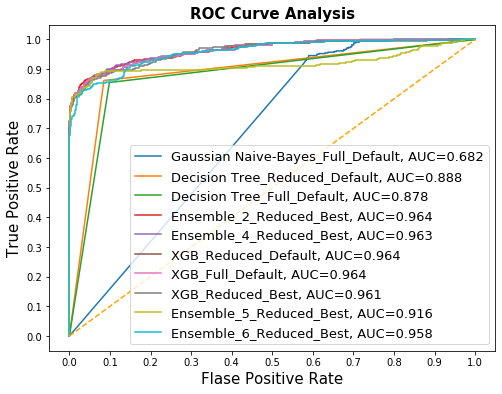

In [89]:
fig = plt.figure(figsize=(8,6))

for i in roc_plot_df.index:
    plt.plot(roc_plot_df.loc[i]['FPR'], 
             roc_plot_df.loc[i]['TPR'], 
             label="{}, AUC={:.3f}".format(i, roc_plot_df.loc[i]['AUC']))
    
plt.plot([0,1], [0,1], color='orange', linestyle='--')

plt.xticks(np.arange(0.0, 1.1, step=0.1))
plt.xlabel("False Positive Rate", fontsize=15)

plt.yticks(np.arange(0.0, 1.1, step=0.1))
plt.ylabel("True Positive Rate", fontsize=15)

plt.title('ROC Curve Analysis', fontweight='bold', fontsize=15)
plt.legend(prop={'size':13}, loc='lower right')

plt.show()